# **Introduction**

# What is OpenCV?
*  OpenCV is a Python image and video processing open source library, which is used for computer vision in 
Artificial intelligence, Machine Learning, face recognition, etc.
*  In OpenCV, the CV is an abbreviation form of a computer vision, which is defined as a field of study that helps computers to understand the content of the digital images such as photographs and videos.

# How does computer recognize the image?
* Human eyes provide lots of information based on what they see. Machines are facilitated with seeing everything, convert the vision into numbers and store in the memory. Here the question arises how computer convert images into numbers. 
* So the answer is that the pixel value is used to convert images into numbers. A pixel is the smallest unit of a digital image or graphics that can be displayed and represented on a digital display device.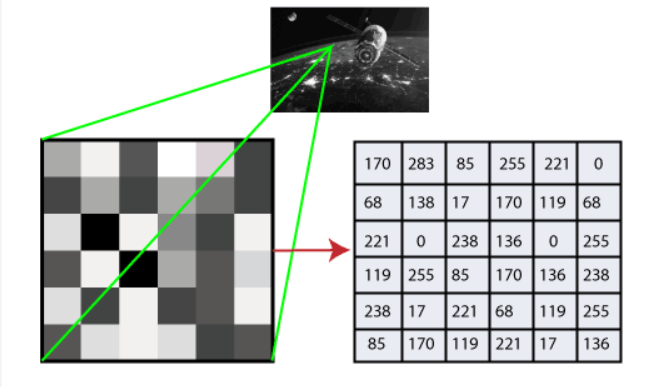
* The picture intensity at the particular location is represented by the numbers. In the above image, we have shown the pixel values for a grayscale image consist of only one value, the intensity of the black color at that location.
* For a coloured image, the combination of red, green and blue colour(RGB) together makes a new color. The computer retrieves that value from each pixel and puts the results in an array to be interpreted.

# Common Imports

In [103]:
import cv2  # This is our main OpenCV module using which we will do all the operations.
from google.colab.patches import cv2_imshow
import numpy as np
from moviepy.editor import *

# **Basic Operations on Images**

**Read and Save Images**

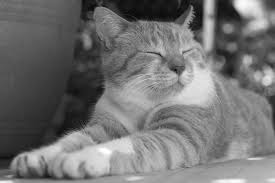

True

In [107]:
img = cv2.imread('/content/cat.jpg',cv2.IMREAD_GRAYSCALE) 
# This imread command is used to read the images. 
# Here we are using IMREAD_GRAYSCALE as a parameter which is used for reading the image in grayscale.
# We can also use simple numbers as parameters like -1, 0, or 1. Color is 1, grayscale is 0, and the unchanged is -1.

cv2_imshow(img) # IMSHOW is used to show the image.

cv2.imwrite('/content/cat_gray.jpg',img) # Imwrite is used to save the image.

# https://docs.opencv.org/2.4/modules/imgproc/doc/miscellaneous_transformations.html#void%20cvtColor%28InputArray%20src,%20OutputArray%20dst,%20int%20code,%20int%20dstCn%29
# Refer to above document to understand how colored images are converted to grayscale values

**Operations on Images**

Pixel Modification

In [137]:
img_color = cv2.imread('/content/cat.jpg',cv2.IMREAD_COLOR)
img_grayscale=cv2.imread('/content/cat_gray.jpg')

#We can retrieve a pixel value by its row and column coordinates. It returns an array of blue, green, red values of the BGR image.
# It returns the corresponding intensity for the grayscale image.

px_color = img_color[20,20] # pixel values at height 1 and width 1 of image
px_grayscale = img_grayscale[20,20]

print(px_color)
print(px_grayscale)

[ 73  89 106]
[93 93 93]


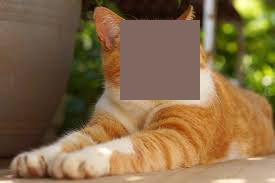

In [138]:
# We can also modify the pixel values 
for i in range(20,100):
  for j in range(120,200):
    img_color[i,j]=[96,104,128]

cv2_imshow(img_color)

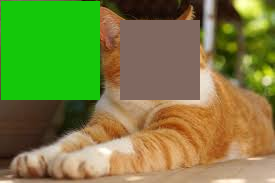

In [139]:
# We can also modify Region of Image
img_color[1:100,1:100] = [10,200,20]

cv2_imshow(img_color)

**Drawing on Images**

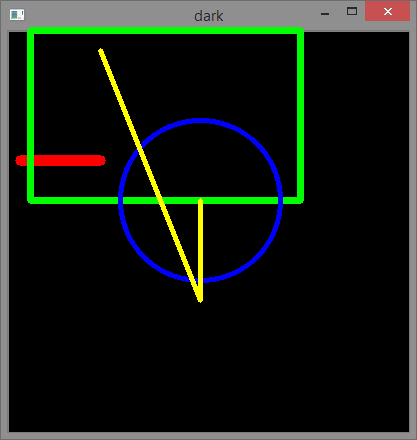

In [140]:
import cv2

img_color = cv2.imread('/content/drawing.jpg',cv2.IMREAD_COLOR)

# Drawing a line on the image using start and end coordinates, colour and thickness of line.
cv2.line(img_color, (20, 160), (100, 160), (0, 0, 255), 10) 

# Drawing a rectangle using top left and bottom right coordinates, colour and thickness of lines.
cv2.rectangle(img_color, (30, 30), (300, 200), (0, 255, 0), 5) 

# Drawing a circle using centre coordinates, radius, colour and thickness. Negative thickness would mean filling the shape.
cv2.circle(img_color, (200, 200), 80, (255, 0, 0), 3)

# Drawing a polygon
pts = np.array([[100,50],[200,300],[200,200]], np.int32) # Initializing the co-ordinates
cv2.polylines(img_color, [pts], False, (0,255,255), 3) # The third argument 'True/False' specifies whether the figure will be a closed figure or an open figure 

cv2_imshow(img_color)

**Writing on Images**

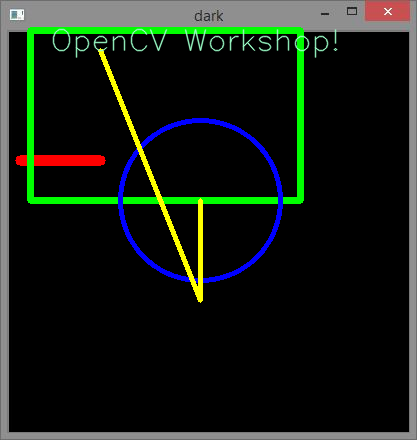

In [141]:
font = cv2.FONT_HERSHEY_SIMPLEX
# Order of parameters: image, text, co-ordinates of starting point(bottom-left corner), font_style, font_size, font_color, px_length,font_type
cv2.putText(img_color,'OpenCV Workshop!',(50,50), font, 1, (200,255,155), 1, cv2.LINE_AA)
cv2_imshow(img_color)

**Arithmetic Operation on Images**

Image Addition

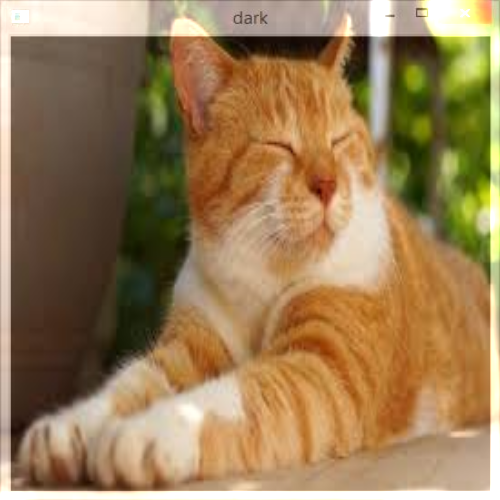

In [142]:
img1=cv2.imread('/content/drawing.jpg')
img1=cv2.resize(img1,(500,500))
img2=cv2.imread('/content/cat.jpg')
img2=cv2.resize(img2,(500,500))
img=cv2.add(img1,img2)
cv2_imshow(img)

# Both images should be of same depth and type, or second image can just be a scalar value.

Image Blending

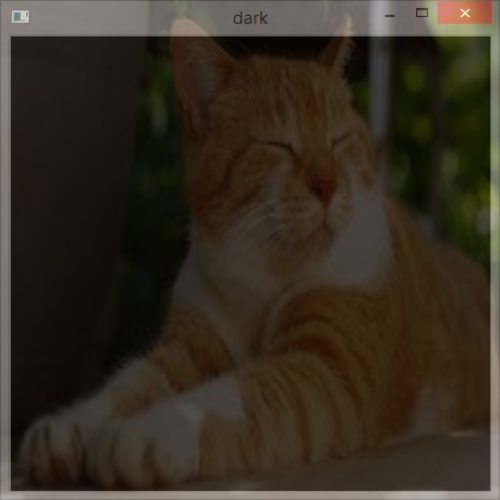

In [143]:
# Weighted adding of images
img = cv2.addWeighted(img1,0.7,img2,0.3,0)
cv2_imshow(img)

Bitwise NOT 

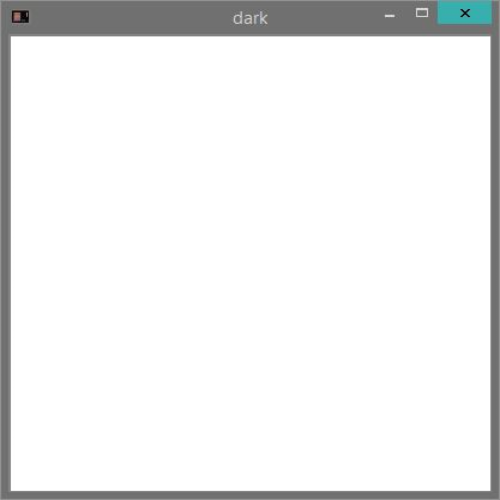

In [144]:
# Negation of pixels
img=cv2.bitwise_not(img1)
cv2_imshow(img)

**Thresholding**


*   The idea of thresholding is to further-simplify visual data for analysis.
*   Suppose we have a grayscale image. So thresholding in this image will convert everything to white or black, based on a threshold value. Let's say we want the threshold to be 125 (out of 255), then everything that was 125 and under would be converted to 0, or black, and everything above 125 would be converted to 255, or white.



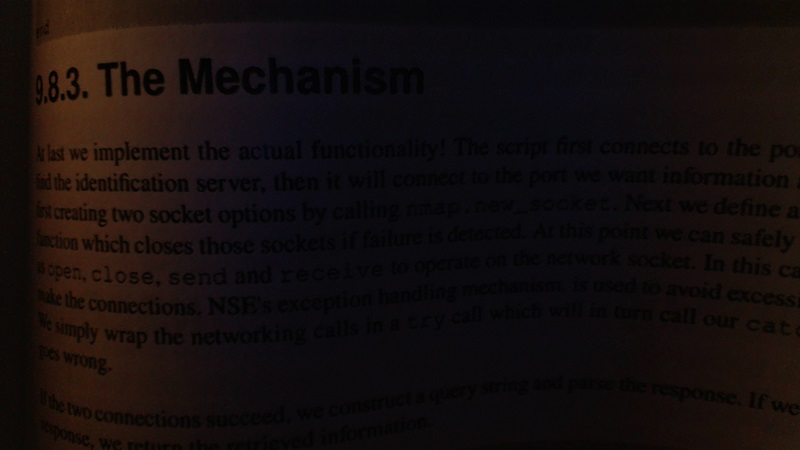

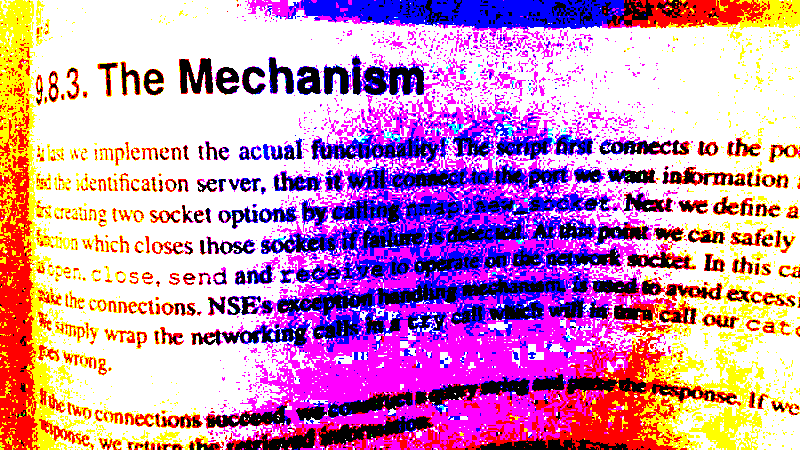

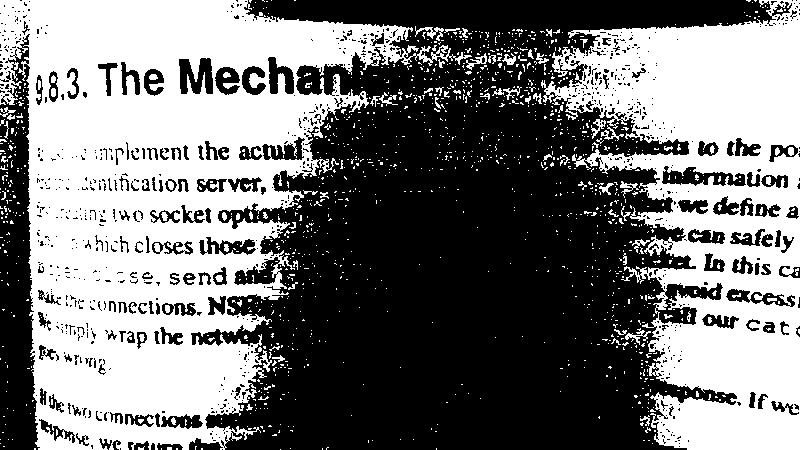

In [145]:
# A simple binary threshold
import cv2

img = cv2.imread('book.jpg')
grayscaled = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)
retval, threshold = cv2.threshold(img, 10, 255, cv2.THRESH_BINARY) #Threshold takes parameters image, threshold, max value and type of threshold.
retval, gray_threshold = cv2.threshold(grayscaled, 12, 255, cv2.THRESH_BINARY)
cv2_imshow(img)
cv2_imshow(threshold)
cv2_imshow(gray_threshold)

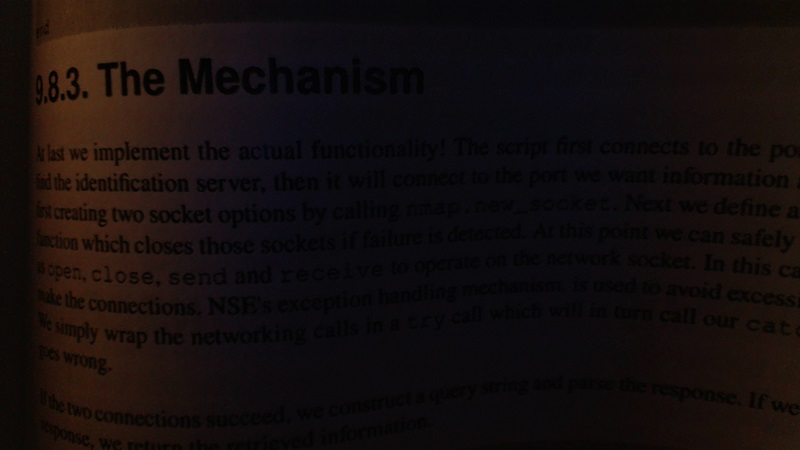

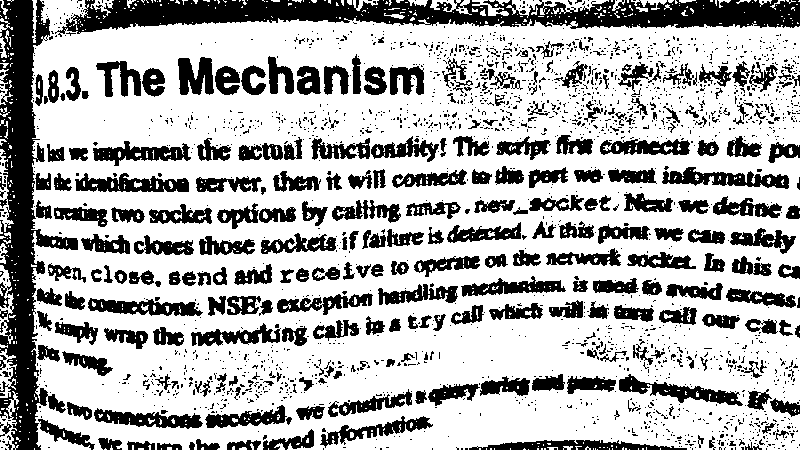

In [146]:
# An adaptive threshold which varies the threshold, also accounts for the curving of pages.

th = cv2.adaptiveThreshold(grayscaled, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY, 115, 1)
cv2_imshow(img)
cv2_imshow(th)

### **Basic Operations on Videos**

**Loading Video Source**

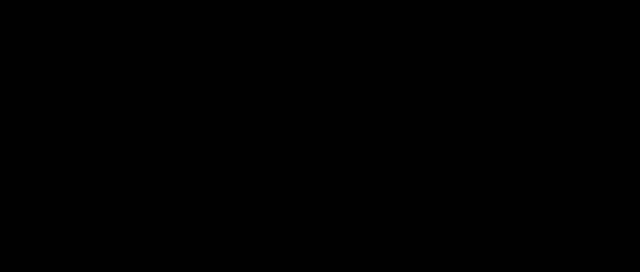

True


In [99]:
cap = cv2.VideoCapture("/content/threshholding.mp4")
ret, frame = cap.read()
cv2_imshow(frame)
print(ret)

In [24]:
import cv2
from moviepy.editor import *

cap = cv2.VideoCapture("/content/threshholding.mp4") # This returns video from the first webcam of your computer.
ret, frame = cap.read()
cap.release()
height , width , _=  frame.shape
print(width , height) # of the video

path = '/content/gray_video.avi'
cap1 = cv2.VideoCapture("/content/threshholding.mp4")
video = cv2.VideoWriter(path,cv2.VideoWriter_fourcc(*'XVID'),9,(width,height),False)
# last one is for having colour image or not
while(True):
    ret, frame = cap1.read() # Initiates an infinite loop, ret is a boolean which indicates whether something is return or not.
    if ret==False:
      break
    gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY) # Here frame is converted to gray using BGR2GRAY attribute.
    video.write(gray) # Using this to show the video stream
cap.release()
cap1.release()
video.release()

clip=VideoFileClip(path)
print(clip.duration)
clip.ipython_display(width=800,maxduration=350)

640 272


  1%|          | 34/2902 [00:00<00:08, 333.67it/s]

322.44


100%|██████████| 2902/2902 [00:09<00:00, 314.77it/s]


**Colour Filtering in OpenCV**

In [28]:
import cv2
import numpy as np

path="/content/color_filter.avi" 
cap = cv2.VideoCapture("/content/threshholding.mp4")
video = cv2.VideoWriter(path,cv2.VideoWriter_fourcc(*'XVID'),9,(width,height)) # last one is for having colour image or not

while(True):
    ret, frame = cap.read()
    if not ret:
      break
    hsv = cv2.cvtColor(frame, cv2.COLOR_BGR2HSV) # Frame is converted from BGR to Hue Saturation Value(HSV). HSV eases the process of filtering a specific colour.
    
    lower_skin = np.array([5,50,50]) # Low intensity skin colour
    upper_skin = np.array([15,255,255]) # High intensity skin colour
    
    mask = cv2.inRange(hsv, lower_skin, upper_skin) # Creates a mask of HSV frame in the range of lower_skin and upper_skin
    res = cv2.bitwise_and(frame,frame, mask= mask) # Creates a result by superimposing the mask on original frame 

    # cv2_imshow(frame)
    # cv2_imshow(mask)
    # cv2_imshow(res)
    video.write(res)
cap.release()
video.release()

clip=VideoFileClip(path)
clip.ipython_display(width=800,maxduration=350)

100%|██████████| 2902/2902 [00:08<00:00, 343.13it/s]


**Canny Edge Detection**

In [32]:
import cv2
from moviepy.editor import *

path = '/content/candy_edge.avi'
cap = cv2.VideoCapture("/content/threshholding.mp4")
video = cv2.VideoWriter(path,cv2.VideoWriter_fourcc(*'XVID'),9,(width,height),False) # last one is for having colour image or not
while(True):
    _, frame = cap.read()
    if not _:
      break
    edges = cv2.Canny(frame,100,200) 
    # Using the Canny function to detect the edges. the arguements used are the original frame, threshold 1, threshold 2.
    #The smallest value between threshold1 and threshold2 is used for edge linking. The largest value is used to find initial segments of strong edges.

    video.write(edges)

video.release()
cap.release()
clip=VideoFileClip(path)
#clip.ipython_display(width=800,maxduration=350)

# Face and Eye Detection using HAAR Cascades

In [33]:
import cv2  
from moviepy.editor import *

face_cascade = cv2.CascadeClassifier(cv2.data.haarcascades + 'haarcascade_frontalface_default.xml')
eye_cascade = cv2.CascadeClassifier(cv2.data.haarcascades + 'haarcascade_eye.xml')

path="/content/face_detect.avi" 
cap = cv2.VideoCapture("/content/threshholding.mp4") 
video = cv2.VideoWriter(path,cv2.VideoWriter_fourcc(*'XVID'),9,(width,height)) # last one is for having colour image or not
  
count = 1
while True:
  
    ret, img = cap.read()  
  
    # Detects faces of different sizes in the input image 
    if not ret:
      break
    faces = face_cascade.detectMultiScale(img, 1.3, 5) 
  
    for (x,y,w,h) in faces: 
        cv2.rectangle(img,(x,y),(x+w,y+h),(255,255,0),2)
        roi_color = img[y:y+h, x:x+w] 
  
        eyes = eye_cascade.detectMultiScale(roi_color)  
  
        for (ex,ey,ew,eh) in eyes: 
            cv2.rectangle(roi_color,(ex,ey),(ex+ew,ey+eh),(0,127,255),2) 

    video.write(img)
cap.release() 
video.release()
clip=VideoFileClip(path)
#clip.ipython_display(width=800,maxduration=350)